사용 가능한 클래스/서브클래스 조합 예시:
  건물 / 건물(집같은)
  건물 / 천 지붕
  건물 / 축사(일부분이 뚫린)
  건물 / 태양광
  건물 / 패널 지붕
  나무 / 나누어진 풀 같은
  나무 / 나무 한그루
  나무 / 숲
  무덤 / 무덤
  밭 / 검은 비닐 덮인
  밭 / 비닐 없는 작물 있는
  밭 / 풀에 덮인 작은 텃밭
  밭 / 풀이 없거나 거의 없는 작은 텃밭
  비닐하우스 / 검은 천 덮인
  비닐하우스 / 뼈대만 있는 비닐하우스
  비닐하우스 / 투명 비닐하우스
  비닐하우스 / 투명 비닐하우스 안 검은 천
  컨테이너 / 컨테이너

/home/dromii4/dromii/owlv2/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


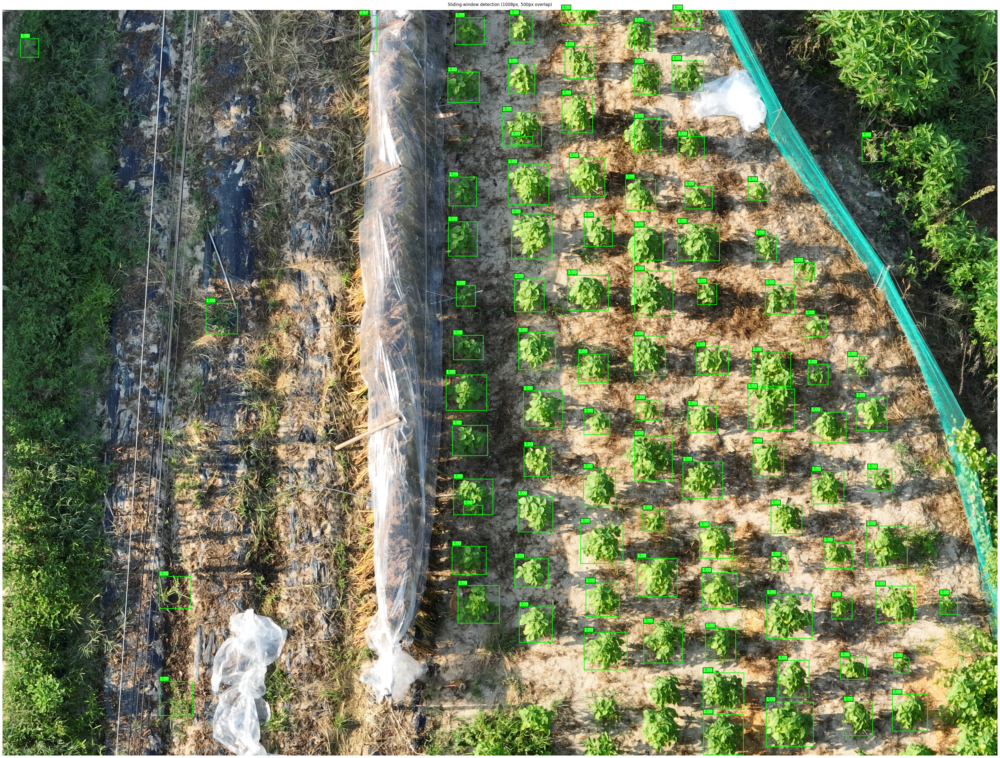

In [1]:
import torch
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from scipy.special import expit as sigmoid
from torchvision.ops import nms
from transformers import Owlv2Processor, Owlv2ForObjectDetection
from transformers.utils.constants import OPENAI_CLIP_MEAN, OPENAI_CLIP_STD

# ─── 1) Imports & Setup ────────────────────────────────────────────────────
DEVICE     = torch.device("cuda" if torch.cuda.is_available() else "cpu")
proc       = Owlv2Processor.from_pretrained("google/owlv2-large-patch14-ensemble")
model      = Owlv2ForObjectDetection.from_pretrained(
    "google/owlv2-large-patch14-ensemble"
).to(DEVICE)
model.eval()

CONF_THRESH = 0.999
IOU_THRESH  = 0.2

def get_vis_arr(pv: torch.Tensor) -> np.ndarray:
    arr  = pv.squeeze().cpu().numpy()
    mean = np.array(OPENAI_CLIP_MEAN)[:, None, None]
    std  = np.array(OPENAI_CLIP_STD)[:, None, None]
    img  = (arr * std + mean) * 255
    return np.clip(img, 0, 255).astype(np.uint8).transpose(1, 2, 0)

# ─── 2) Load saved embeddings from whole_crop_index ─────────────────────────
data = torch.load("whole_crop_index.pt")
embs = data["embeddings"]   # [N_patches, D]
meta = data["metadata"]      # list of N_patches dicts

# ─── 3) Filter for our subclass and compute the mean embedding ─────────────
indices = [
    i for i, m in enumerate(meta)
    if m.get("class_name") == "나무" and m.get("subclass") == "나누어진 풀 같은"
]
if not indices:
    raise ValueError("No embeddings for 나무/숲 in whole_crop_index.pt")


sub_embs = embs[indices].to(DEVICE)                   # [K, D]
mean_emb = sub_embs.mean(dim=0, keepdim=True)         # [1, D]
q        = mean_emb.unsqueeze(1)                     # [1, 1, D] for class_predictor

# ─── 4) Prepare original image & sliding windows ──────────────────────────
target_path = "encumbrance_labels/encumbrance/DJI_0928.jpg"
orig_img    = Image.open(target_path).convert("RGB")
W_orig, H_orig = orig_img.size

tile_size = 1008
overlap   = 500
stride    = tile_size - overlap

# compute start positions so last tile aligns to edge
x_starts = list(range(0, max(W_orig - tile_size, 0) + 1, stride))
if W_orig > tile_size and x_starts[-1] != W_orig - tile_size:
    x_starts.append(W_orig - tile_size)
if W_orig <= tile_size:
    x_starts = [0]

y_starts = list(range(0, max(H_orig - tile_size, 0) + 1, stride))
if H_orig > tile_size and y_starts[-1] != H_orig - tile_size:
    y_starts.append(H_orig - tile_size)
if H_orig <= tile_size:
    y_starts = [0]

global_boxes = []
global_scores = []

# ─── 5) Process each tile ─────────────────────────────────────────────────
for y0 in y_starts:
    for x0 in x_starts:
        tile = orig_img.crop((x0, y0, x0 + tile_size, y0 + tile_size))

        # OWL-V2 preprocessing
        inputs = proc(images=tile, return_tensors="pt").to(DEVICE)
        pv     = inputs["pixel_values"]         # [1,3,P,P]
        vis    = get_vis_arr(pv)                # [P,P,3]
        P      = vis.shape[0]                   # P == 1008

        # extract features & raw boxes
        with torch.no_grad():
            fmap    = model.image_embedder(pv)[0]                          # [1, hf, wf, D]
            B, hf, wf, D = fmap.shape
            feats   = fmap.reshape(B, hf*wf, D)                            # [1, N, D]
            boxes_n = model.box_predictor(feats, feature_map=fmap)[0].cpu().numpy()  # [N,4]

            logits, _ = model.class_predictor(feats, q)                    # [1, N, 1]
        scores = sigmoid(logits[0,:,0].cpu().numpy())                     # [N]

        # threshold & fallback
        inds = np.where(scores > CONF_THRESH)[0]
        if len(inds) == 0:
            inds = [int(scores.argmax())]

        # to pixel boxes on P×P
        pixel_boxes, scores_sel = [], []
        for i in inds:
            cx, cy, bw, bh = boxes_n[i]
            x1, y1 = (cx - bw/2)*P, (cy - bh/2)*P
            x2, y2 = (cx + bw/2)*P, (cy + bh/2)*P
            x1, y1 = max(x1,0), max(y1,0)
            x2, y2 = min(x2,P), min(y2,P)
            pixel_boxes.append((x1, y1, x2, y2))
            scores_sel.append(scores[i])

        # tile-level NMS
        if pixel_boxes:
            tb      = torch.tensor(pixel_boxes, device=DEVICE)
            ts      = torch.tensor(scores_sel, device=DEVICE)
            keep    = nms(tb, ts, IOU_THRESH).cpu().numpy()
            boxes_nm = [pixel_boxes[i] for i in keep]
            scores_nm= [scores_sel[i]  for i in keep]
        else:
            boxes_nm, scores_nm = [], []

        # remove nested
        tile_boxes, tile_scores = [], []
        for i,(x1,y1,x2,y2) in enumerate(boxes_nm):
            inside = False
            for j,(xx1,yy1,xx2,yy2) in enumerate(boxes_nm):
                if i!=j and xx1<=x1 and yy1<=y1 and xx2>=x2 and yy2>=y2:
                    inside = True
                    break
            if not inside:
                tile_boxes.append((x1,y1,x2,y2))
                tile_scores.append(scores_nm[i])

        # map each tile box back to original coords
        for (x1,y1,x2,y2), sc in zip(tile_boxes, tile_scores):
            x1_o = x1/P * tile_size + x0
            y1_o = y1/P * tile_size + y0
            x2_o = x2/P * tile_size + x0
            y2_o = y2/P * tile_size + y0
            global_boxes.append((x1_o, y1_o, x2_o, y2_o))
            global_scores.append(sc)

# ─── 6) Global NMS across all tiles ────────────────────────────────────────
if global_boxes:
    tb       = torch.tensor(global_boxes, device=DEVICE)
    ts       = torch.tensor(global_scores, device=DEVICE)
    keep_gl  = nms(tb, ts, IOU_THRESH).cpu().numpy()
    final_boxes  = [global_boxes[i] for i in keep_gl]
    final_scores = [global_scores[i] for i in keep_gl]
else:
    final_boxes, final_scores = [], []

# ─── 7) Visualize on the ORIGINAL image ────────────────────────────────────
fig, ax = plt.subplots(
    figsize=(W_orig/100, H_orig/100),
    dpi=100
)
ax.imshow(orig_img)
ax.axis("off")
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

for (x1,y1,x2,y2), sc in zip(final_boxes, final_scores):
    ax.add_patch(plt.Rectangle(
        (x1, y1), x2-x1, y2-y1,
        edgecolor="lime", facecolor="none", linewidth=2
    ))
    ax.text(
        x1, y1-6, f"{sc:.2f}",
        color="white", fontsize=12,
        bbox={"facecolor":"lime","pad":1}
    )

ax.set_title("Sliding-window detection (1008px, 500px overlap)", pad=12)
plt.show()
